## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

The images for camera calibration are stored in the folder called `camera_cal`.  The images in `test_images` are for testing your pipeline on single frames.  If you want to extract more test images from the videos, you can simply use an image writing method like `cv2.imwrite()`, i.e., you can read the video in frame by frame as usual, and for frames you want to save for later you can write to an image file.  

To help the reviewer examine your work, please save examples of the output from each stage of your pipeline in the folder called `output_images`, and include a description in your writeup for the project of what each image shows.    The video called `project_video.mp4` is the video your pipeline should work well on.  

The `challenge_video.mp4` video is an extra (and optional) challenge for you if you want to test your pipeline under somewhat trickier conditions.  The `harder_challenge.mp4` video is another optional challenge and is brutal!

If you're feeling ambitious (again, totally optional though), don't stop there!  We encourage you to go out and take video of your own, calibrate your camera and show us how you would implement this project from scratch!


In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

# Camera calibration

Let's display some of the calibration images first, so we have some idea what we are dealing with.

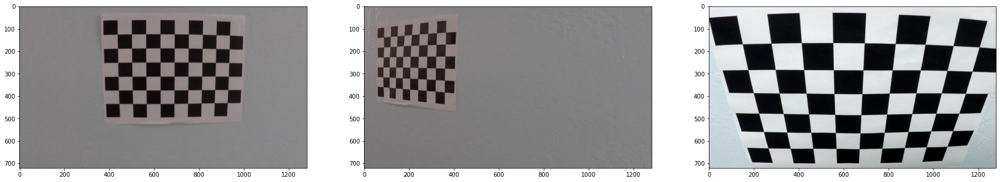

In [2]:
calibrationImages = glob.glob('camera_cal/calibration*.jpg')
fig, axes = plt.subplots(1, 3, figsize=(30, 30))

for name, ax in zip(calibrationImages[9:12], axes.ravel()):
    img = cv2.imread(name)
    # plot image into the subplot
    ax.imshow(img[:,::])

Ok, so let's iterate over the images and draw the corners.

In [3]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Step through the list and search for chessboard corners
for name, ax in zip(calibrationImages, axes.ravel()):
    img = cv2.imread(name)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

We were not able to find the corners in three images. The picture is zoomed too closely and we don't see the required 9x6 chessboard. Let's calibrate the camera now and display the result on one of heavily distorted images.

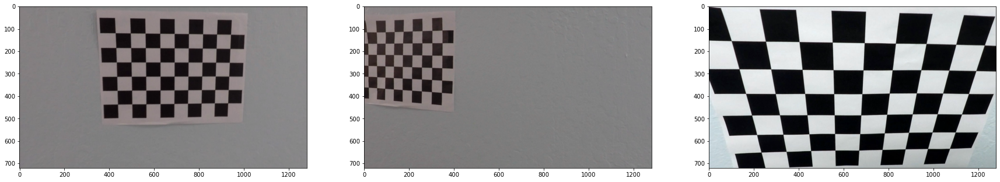

In [4]:
def img_undistort(img, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

fig, axes = plt.subplots(1, 3, figsize=(30, 30))

for name, ax in zip(calibrationImages[9:12], axes.ravel()):
    img = cv2.imread(name)
    
    # undistort the image and display results
    udst = img_undistort(img, objpoints, imgpoints)
    ax.imshow(udst[:,::])

Looks good! 

# Distortion correction
The camera is calibrated now, so we can correct for the distortion in raw images. 

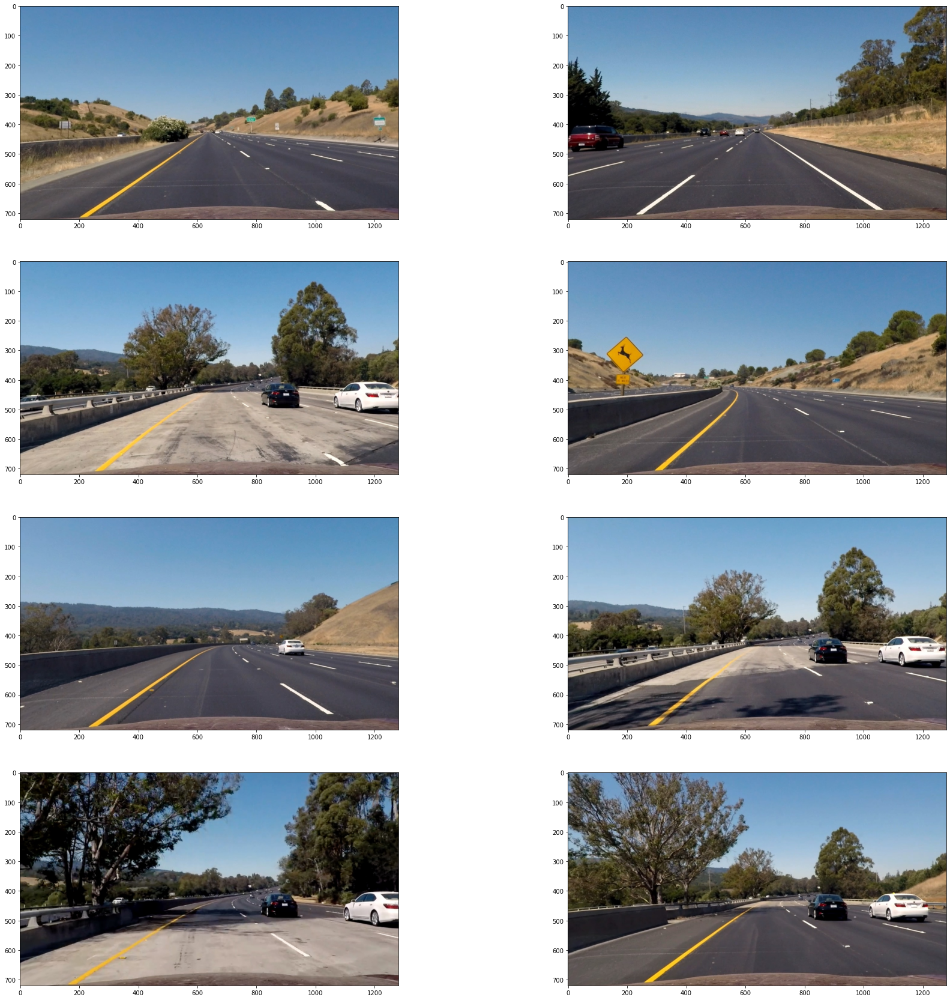

In [5]:
rawImages = glob.glob('test_images/*.jpg')
# list for corrected raw images
testImages = []

fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for name, ax in zip(rawImages, axes.ravel()):
    img = cv2.imread(name)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    udst = img_undistort(img, objpoints, imgpoints)
    testImages.append(udst)
    ax.imshow(udst[:,::])

# Region of interest

Define good ROI to prevent false positives in the image.

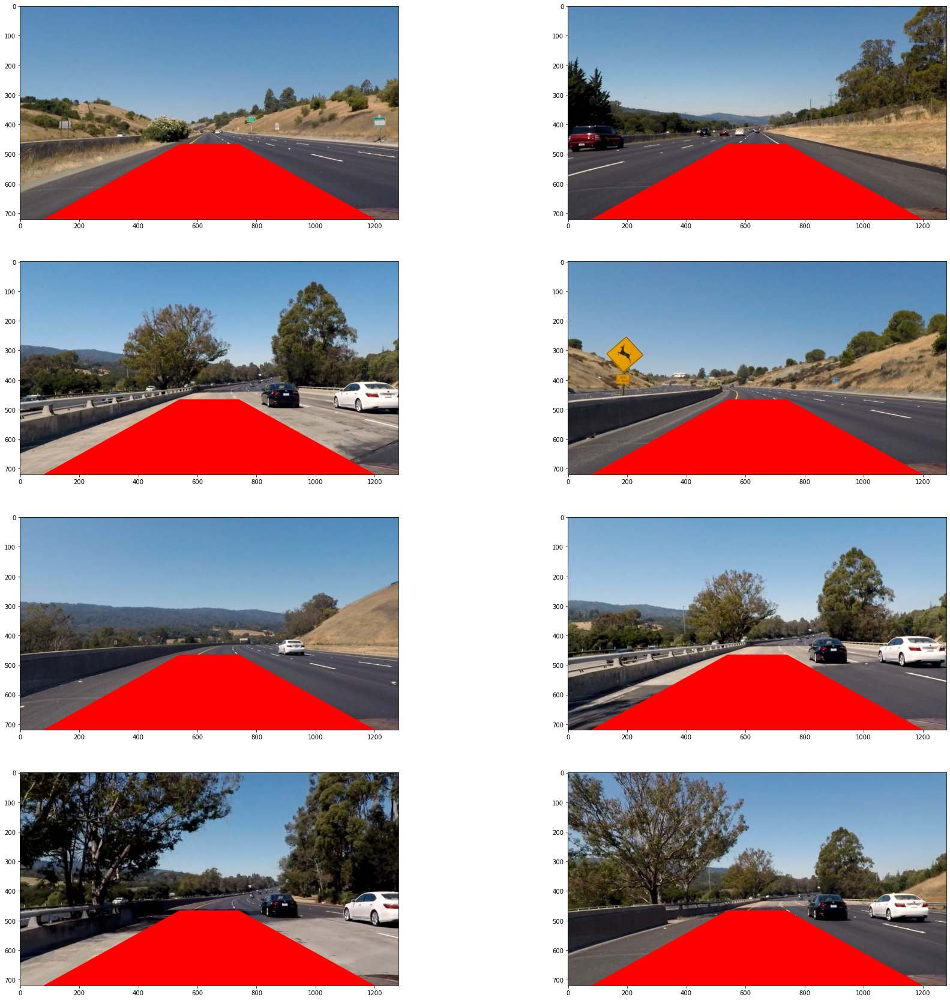

In [6]:
x_center = testImages[0].shape[1]/2
x_lo_offset = 560
x_hi_offset = 100
y_lo = testImages[0].shape[0]
y_hi = int(testImages[0].shape[1]/3) + 40

vertices = np.array([[(x_center - x_lo_offset, y_lo), (x_center - x_hi_offset, y_hi), (x_center + x_hi_offset, y_hi), (x_center + x_lo_offset, y_lo)]], dtype=np.int32)

fig, axes = plt.subplots(4, 2, figsize=(30, 30))
for image, ax in zip(testImages, axes.ravel()):
    img = np.copy(image)
    poly = cv2.fillPoly(img, vertices, 255)
    ax.imshow(poly)

In [7]:
def region_of_interest(img, vertices):
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


# Thresholded binary image
Since we prepared our test images, we can proceed with using different techniques to identify the lane lines.

## Directional gradient threshold
We will use the Sobel operator to create directional gradient. We will use the method created in curicullum quiz.

In [8]:
def abs_sobel_thresh(image, orient='x', sobel_kernel=3, thresh=(0, 255)):
    img = np.copy(image)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    sbinary = np.zeros_like(scaled_sobel)
    sbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return sbinary

Let's apply it now to the test images:

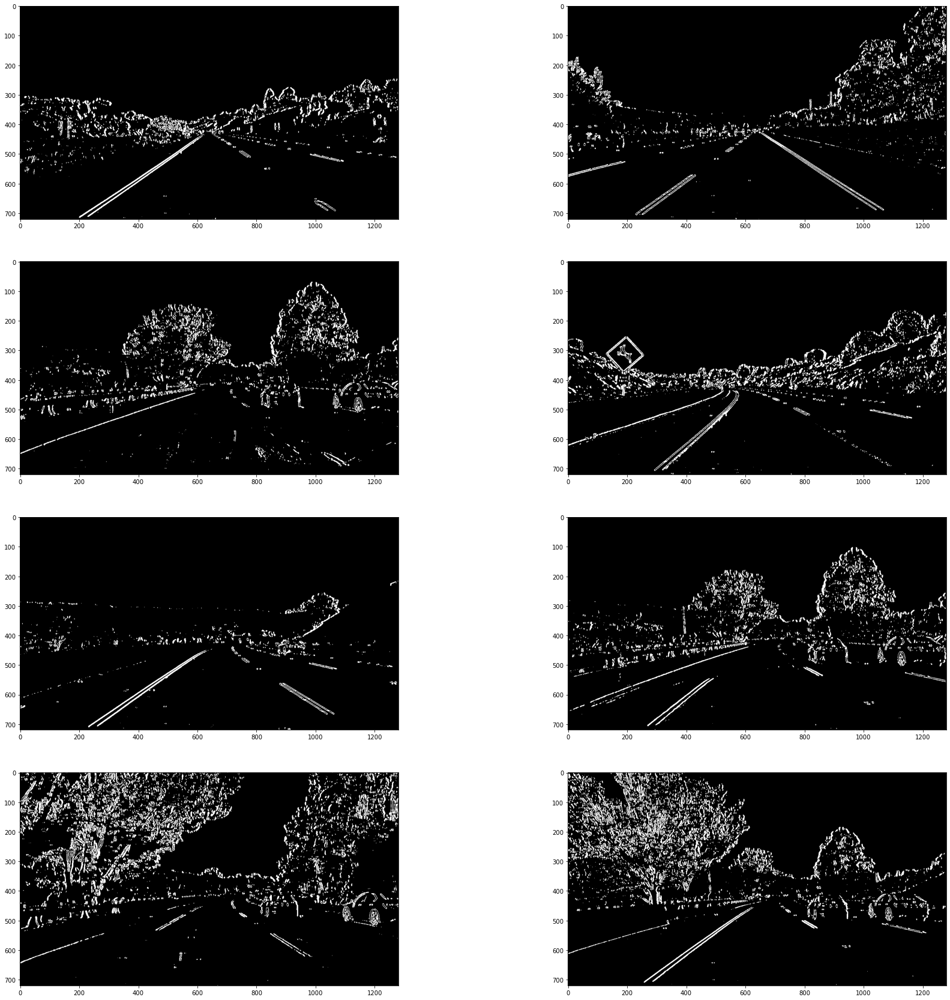

In [9]:
abs_sobel_threshold=(30, 120)
abs_sobel_threshold_ksize=9

fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    grad_binary = abs_sobel_thresh(image, orient='x', sobel_kernel=abs_sobel_threshold_ksize, thresh=abs_sobel_threshold)
    ax.imshow(grad_binary, cmap='gray')

## Magnitude of gradient

Let's try to build the magnitude of gradient for sobel x and y.

In [10]:
def mag_thresh(image, sobel_kernel=3, thresh=(0, 255)):
    img = np.copy(image)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel )
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    abs_sobelxy= np.sqrt(sobelx ** 2 + sobely ** 2)
    scaled_sobel = np.uint8(255 * abs_sobelxy / np.max(abs_sobelxy))
    
    sbinary = np.zeros_like(scaled_sobel)
    sbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return sbinary

Let's apply it now to the test images:

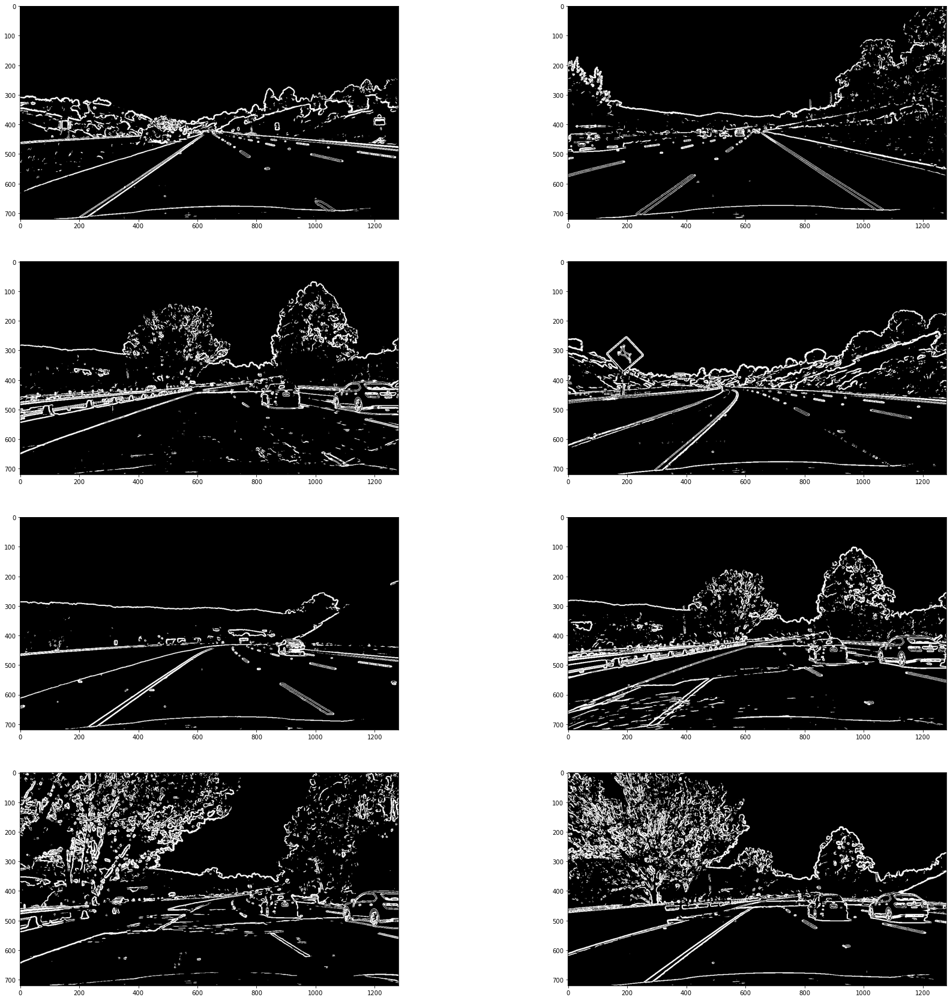

In [11]:
mag_threshold=(40, 150)
mag_thresh_ksize=9

fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    mag_binary = mag_thresh(image, sobel_kernel=mag_thresh_ksize, thresh=mag_threshold)
    ax.imshow(mag_binary, cmap='gray')

## Direction of gradient
Let's explore the effect of direction thresholding.

In [12]:
def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    img = np.copy(image)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    grad_dir = np.arctan2(abs_sobely, abs_sobelx)
    
    binary_output = np.zeros_like(grad_dir)
    binary_output[(grad_dir >= thresh[0]) & (grad_dir <= thresh[1])] = 1

    return binary_output

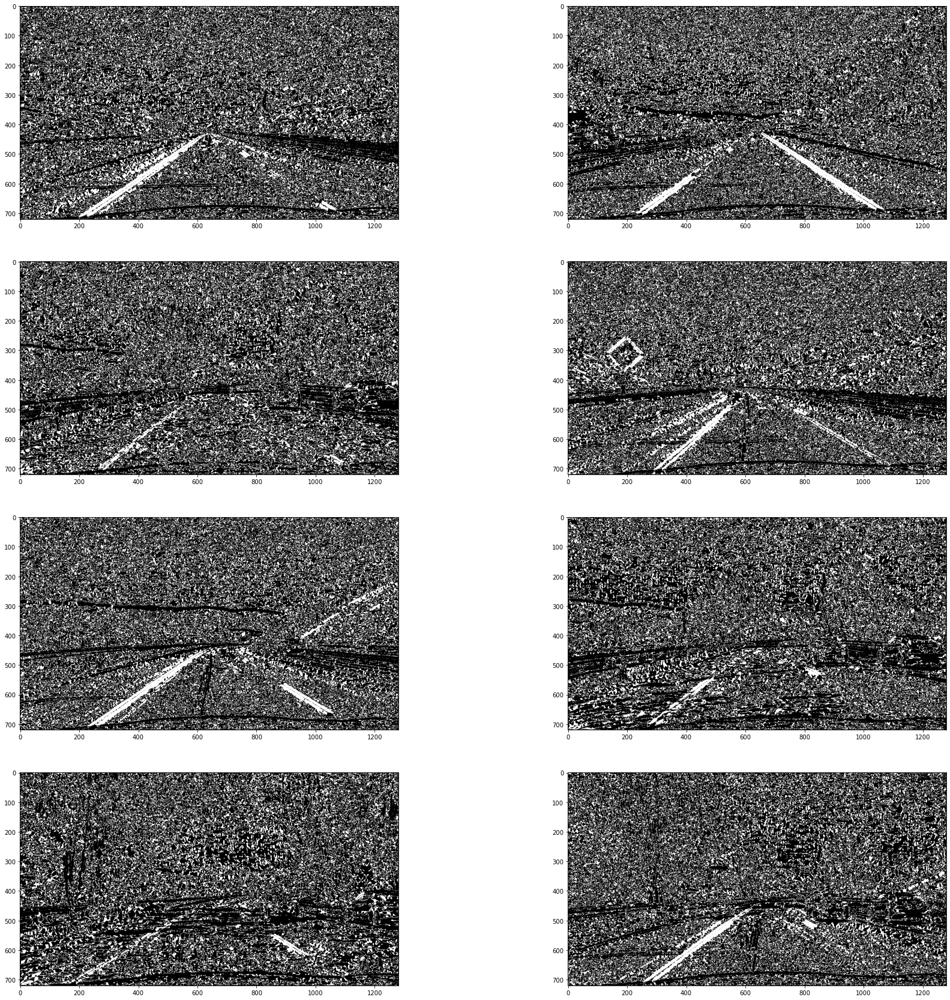

In [13]:
dir_binary_threshold=(0.7, 1.2)
dir_binary_ksize=15

fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    dir_binary = dir_threshold(image, sobel_kernel=dir_binary_ksize, thresh=dir_binary_threshold)
    ax.imshow(dir_binary, cmap='gray')

# HLS threshold - S channel

I use HLS colorspace to emphasize on lane lines in various lighting conditions.

In [14]:
def hls_select(image, thresh=(0, 255)):
    img = np.copy(image)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS) # placeholder line
    S = hls[:,:,2]
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1

    return binary

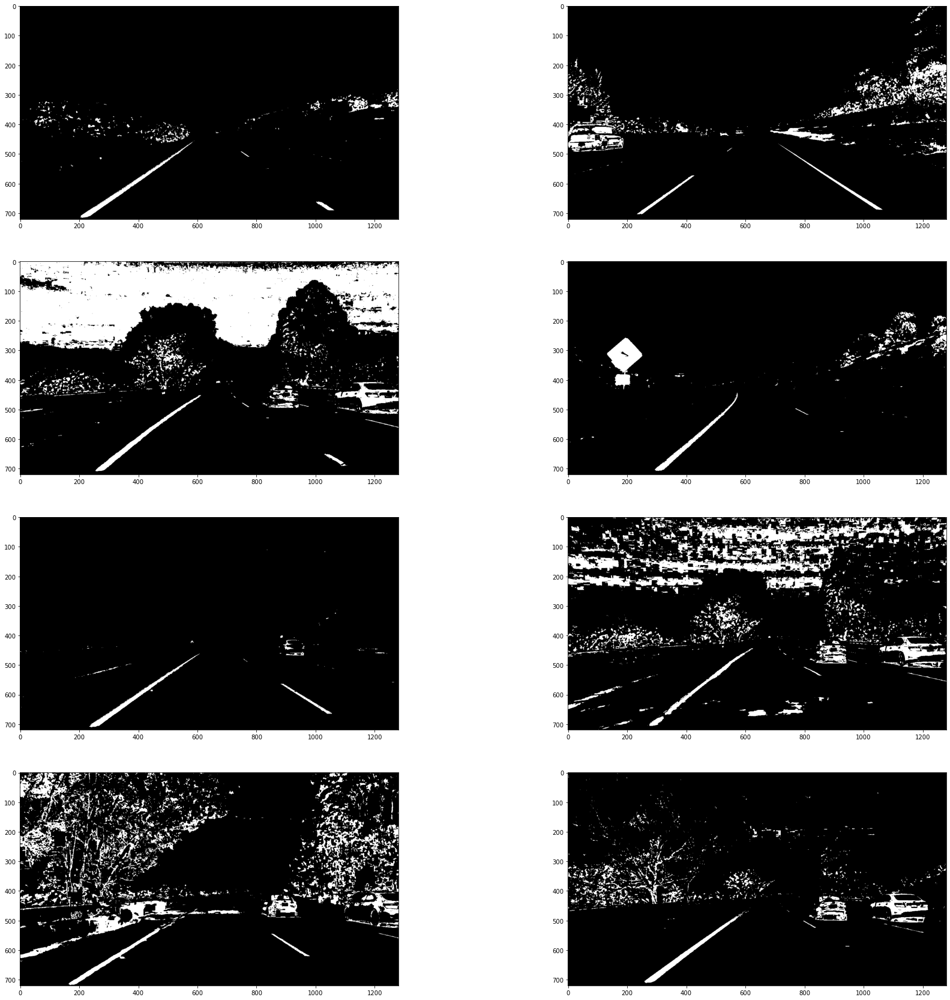

In [15]:
fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    hls_binary = hls_select(image, thresh=(120, 255))
    ax.imshow(hls_binary, cmap='gray')

# HLS threshold - H channel

I use the H channel to detect the shadows in the image. The inverse can be used to filter them out.

In [16]:
def hls_h_select(image, thresh=(70, 255)):
    img = np.copy(image)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS) # placeholder line
    c = hls[:,:,0]
    binary = np.zeros_like(c)
    binary[(c > thresh[0]) & (c <= thresh[1])] = 1

    return binary

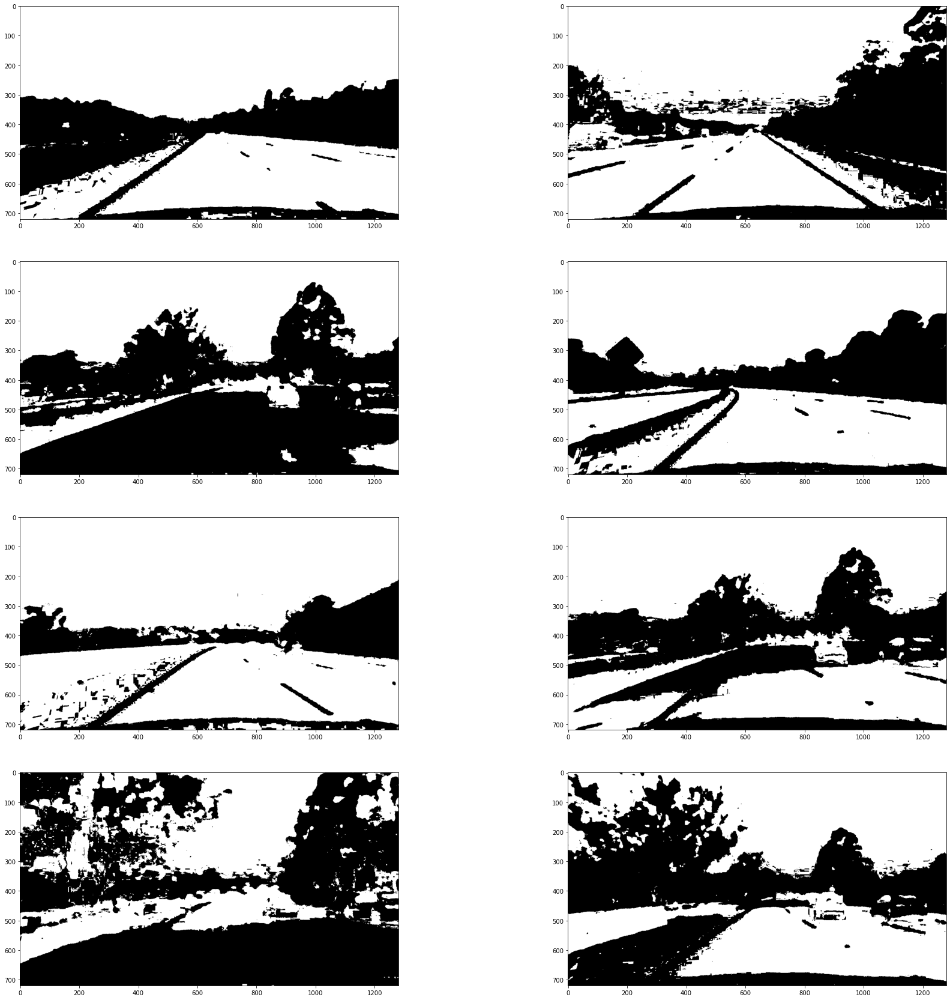

In [17]:
fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    hls_binary = hls_h_select(image, thresh=(100, 255))
    ax.imshow(hls_binary, cmap='gray')

## Combined threshold

Now, let's apply all the filter and ROI selection to the image. The idea is to see (mostly) the lane lines.

In [18]:
def combined_thres(img):
    image = np.copy(img)
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=abs_sobel_threshold_ksize, thresh=abs_sobel_threshold)
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=abs_sobel_threshold_ksize, thresh=abs_sobel_threshold)
    mag_binary = mag_thresh(image, sobel_kernel=mag_thresh_ksize, thresh=mag_threshold)
    dir_binary = dir_threshold(image, sobel_kernel=dir_binary_ksize, thresh=dir_binary_threshold)
    hls_binary = hls_select(image, (120, 255))
    hls_h_binary = hls_h_select(image, thresh=(100, 255))
    
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | ((hls_binary == 1) & (dir_binary == 1)) ] = 1
    combined[hls_h_binary == 1] = 0
    roi = region_of_interest(combined, vertices)
    
    return roi

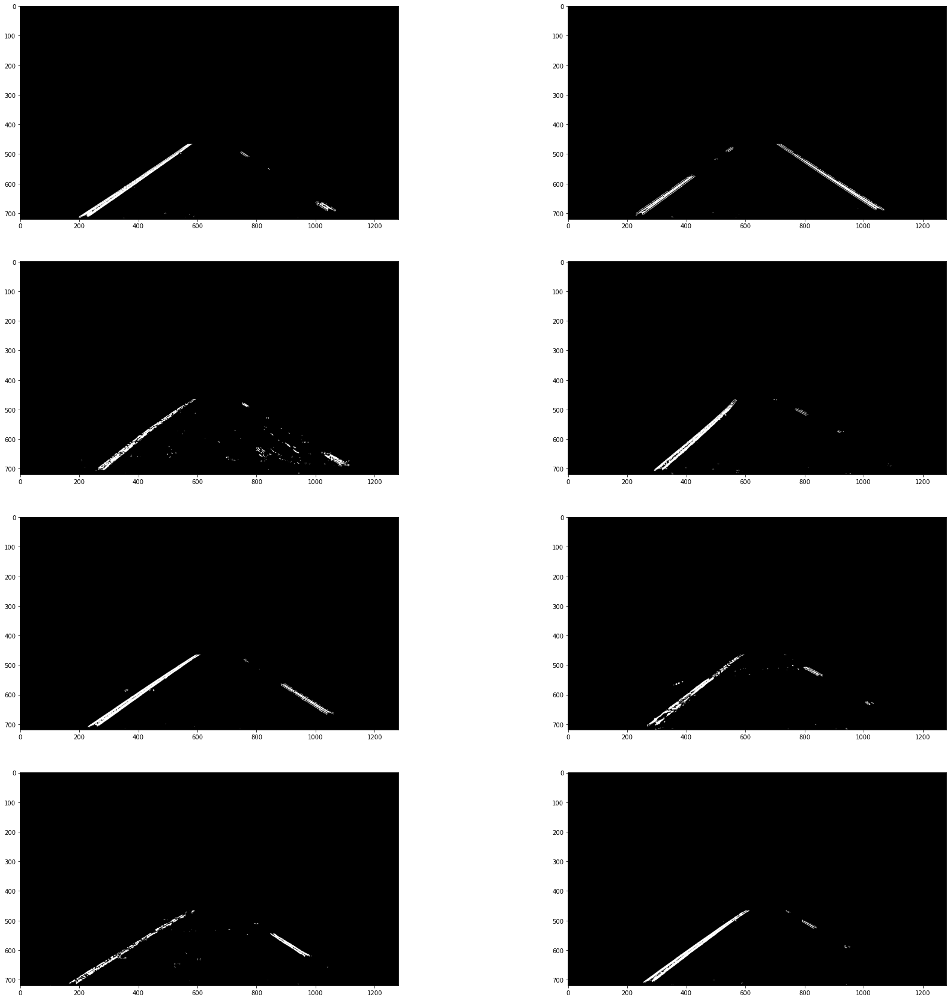

In [19]:
fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    ax.imshow(combined_thres(image), cmap='gray')

# Birds-eye perspective transform

Since we were able to detect the lane lines, we need to warp the perspective so we can see the curvature of the lanes.

In [20]:
warp_offset = 300
warp_src = np.float32(vertices)
warp_dst = np.float32([[warp_offset, img.shape[0]], 
                       [warp_offset - 70, 0], 
                       [img.shape[1] - warp_offset + 70, 0], 
                       [img.shape[1] - warp_offset, img.shape[0]]])
M = cv2.getPerspectiveTransform(warp_src, warp_dst)
Minv = cv2.getPerspectiveTransform(warp_dst, warp_src)

def warp(img):
    warped = cv2.warpPerspective(img, M, img.shape[1::-1], flags=cv2.INTER_LINEAR)
    return warped

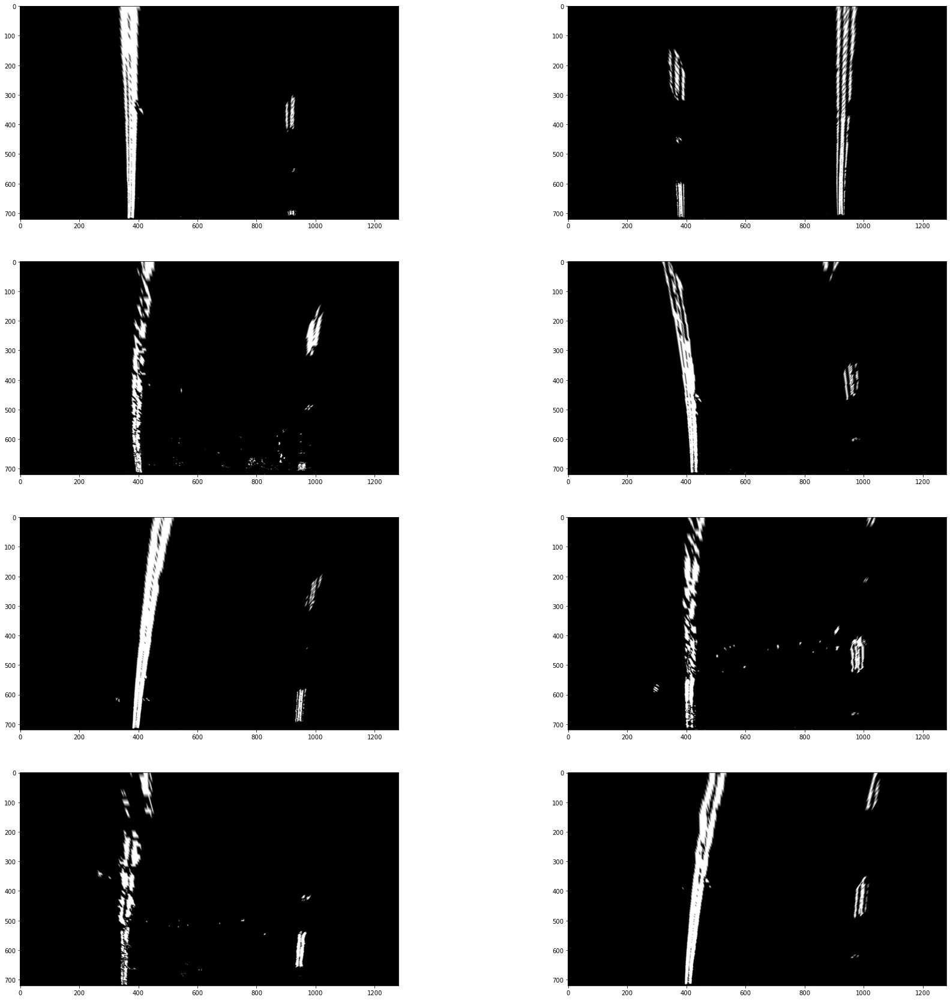

In [21]:
fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    warped = warp(combined_thres(image))
    ax.imshow(warped, cmap='gray')

# Finding the lane lines
Now that we transformed our image int birds-eye perspective, we can try to actually locate the lane lines.

## Finding histogram peaks

First step is to caclulate histogram as sum of white pixels on x axis.

In [22]:
def hist(image):
    img = np.int32(np.where(image > 0, 1, 0))
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)    
    return histogram

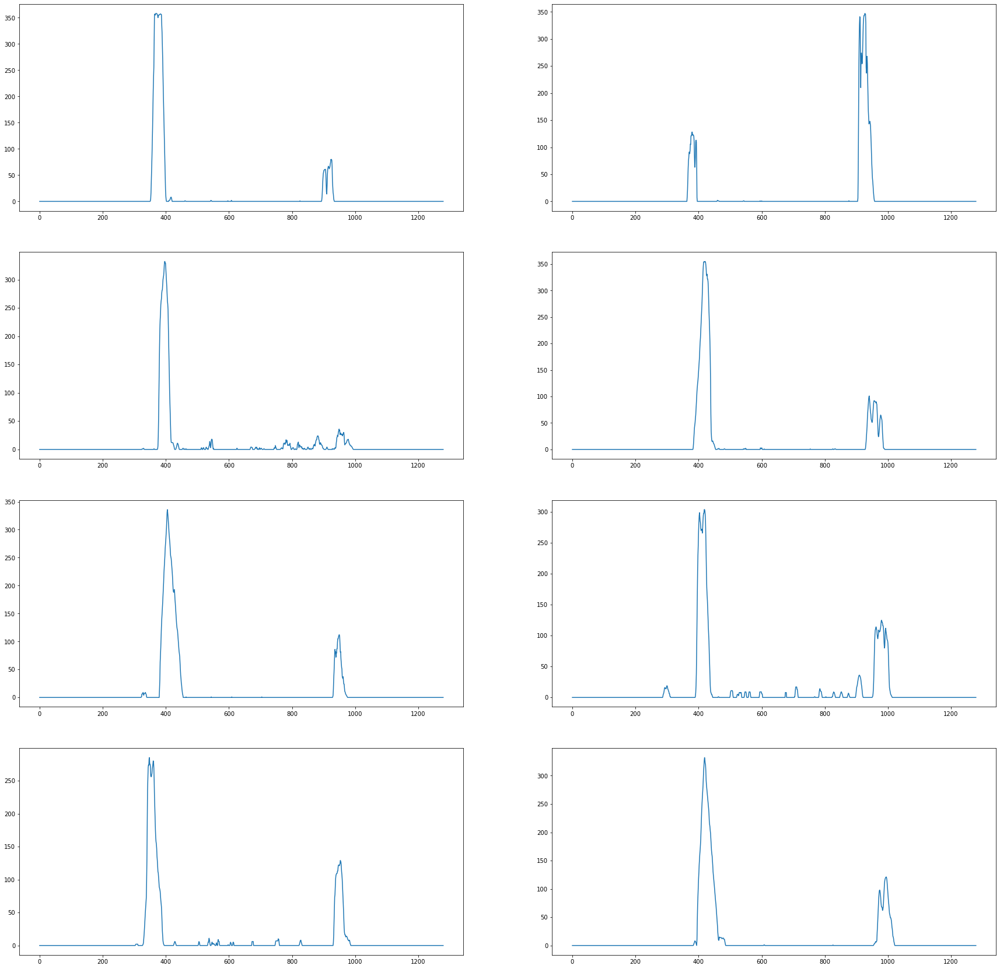

In [23]:
fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    top_down = warp(combined_thres(image))
    ax.plot(hist(top_down))

## Sliding windows
Once we found the histogram, we can use the sliding windows technique to identify x and y coordinates for lane line pixels. 

In [24]:
# HYPERPARAMETERS
# Choose the number of sliding windows
nwindows = 10
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 80

def find_lane_pixels(binary_warped, side):
    # Take a histogram of the bottom half of the image
    histogram = hist(binary_warped)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    
    if side == "left":
        x_base = np.argmax(histogram[:midpoint])
    else:
        x_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    x_current = x_base

    # Create empty lists to receive left and right lane pixel indices
    lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        
        ### Find the boundaries of the window ###
        win_x_low = x_current - margin  
        win_x_high = x_current + margin
       
        ### Identify the nonzero pixels in x and y within the window ###
        good_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_x_low) &  (nonzerox < win_x_high)).nonzero()[0]
        # Append these indices to the list
        lane_inds.append(good_inds)
        
        ### If we found > minpix pixels, recenter next window ###
        ### (x_current) on their mean position ###
        if len(good_inds) > minpix:
            x_current = np.int(np.mean(nonzerox[good_inds]))
        
    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        lane_inds = np.concatenate(lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    x = nonzerox[lane_inds]
    y = nonzeroy[lane_inds] 
  
    return x, y

def fit_polynomial(img, ploty, x, y):
    ### Fit a second order polynomial to each with np.polyfit() ###
    fit = np.polyfit(y, x, 2)
    fitx = fit[0]*ploty**2 + fit[1]*ploty + fit[2]
    
    return fitx, fit

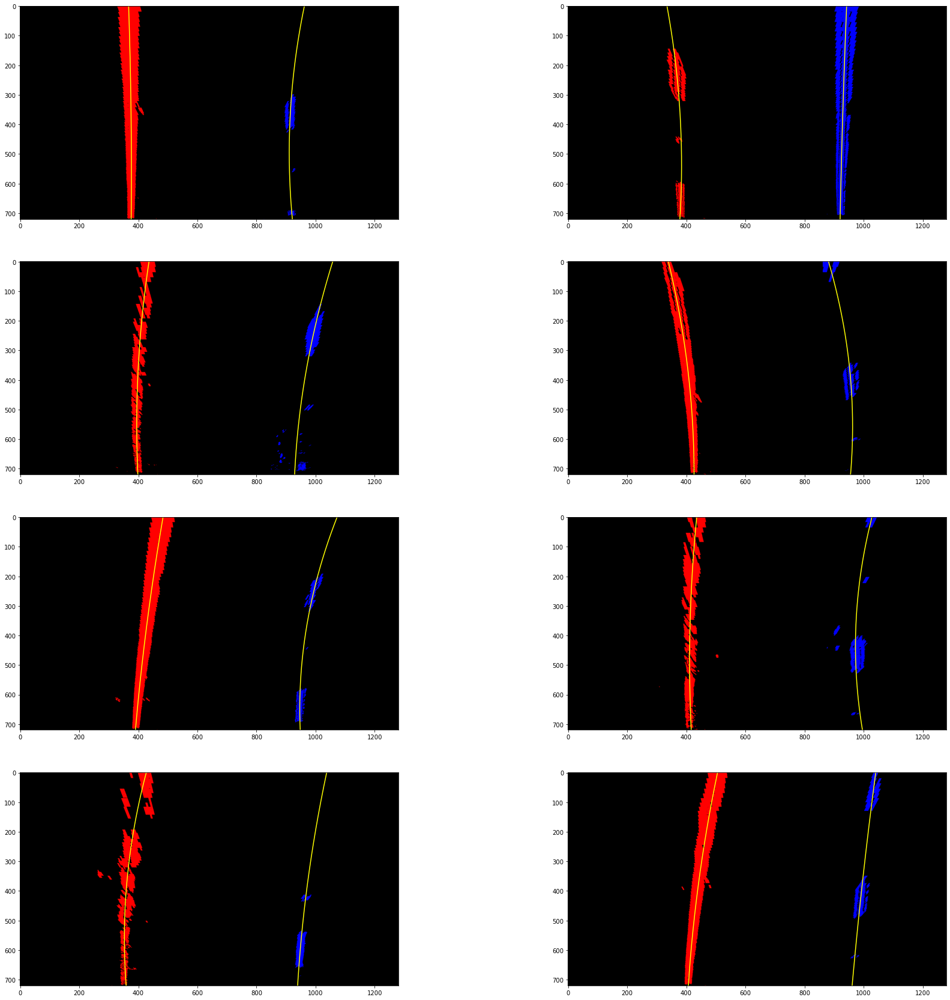

In [25]:
fig, axes = plt.subplots(4, 2, figsize=(30, 30))

for image, ax in zip(testImages, axes.ravel()):
    binary_warped = warp(combined_thres(image))
    # generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    
    # Find our lane pixels first
    leftx, lefty = find_lane_pixels(binary_warped, side="left")
    rightx, righty = find_lane_pixels(binary_warped, side="right")
    
    left_fitx, l_fit = fit_polynomial(binary_warped, ploty, leftx, lefty)
    right_fitx, r_fit = fit_polynomial(binary_warped, ploty, rightx, righty)
   
    ## Visualization ##
    # Colors in the left and right lane regions
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((top_down, top_down, top_down))
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    ax.plot(left_fitx, ploty, color='yellow')
    ax.plot(right_fitx, ploty, color='yellow')
    ax.imshow(out_img.astype('uint8'))

In [26]:
# HYPERPARAMETER
# Choose the width of the margin around the previous polynomial to search
margin = 90

def search_around_poly(binary_warped, ploty, last_fit):
    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
     
    ### Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Identify the nonzero pixels in x and y within the window ###
    lane_inds = ((nonzerox > (last_fit[0]*(nonzeroy**2) + last_fit[1]*nonzeroy + 
                    last_fit[2] - margin)) & (nonzerox < (last_fit[0]*(nonzeroy**2) + 
                    last_fit[1]*nonzeroy + last_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    x = nonzerox[lane_inds]
    y = nonzeroy[lane_inds] 
    
    return x, y

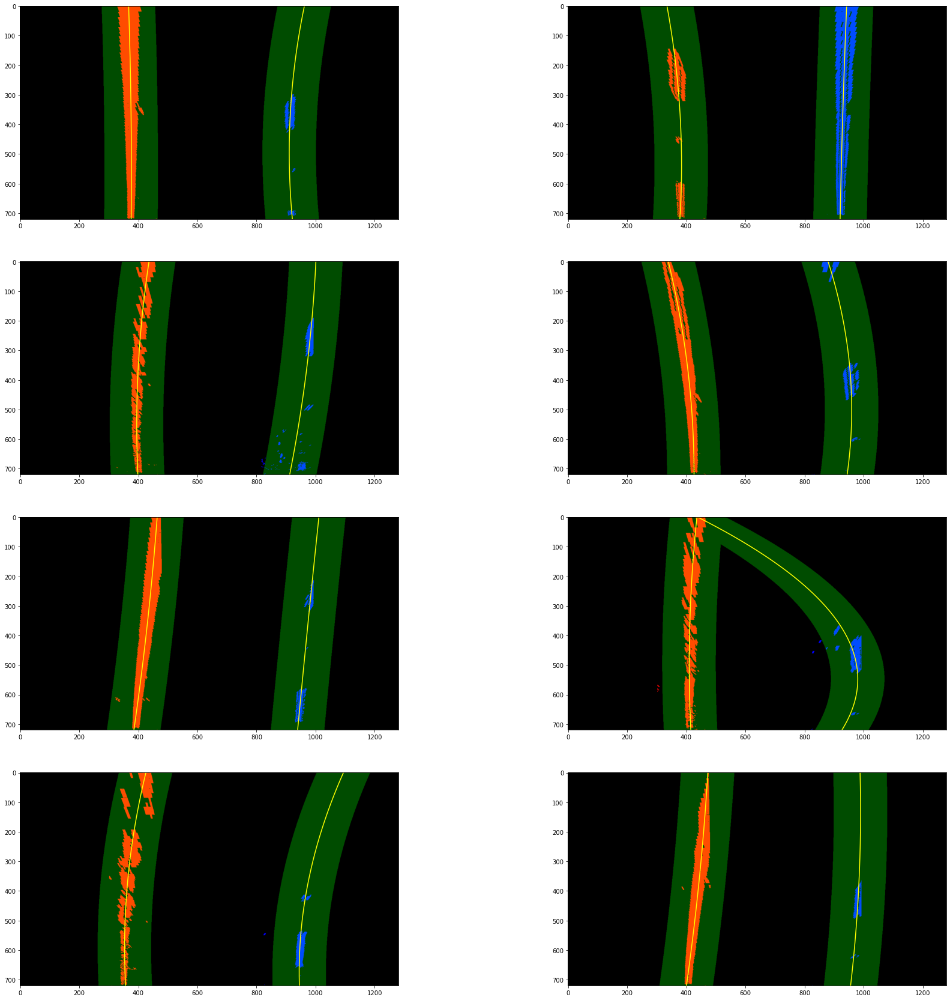

In [27]:
fig, axes = plt.subplots(4, 2, figsize=(30, 30))

last_left_fit = [-2.09677842e-05, 2.41458184e-02, 3.85984289e+02]
last_right_fit = [ 2.07177017e-05, -1.79811575e-02, 9.05991712e+02]

for image, ax in zip(testImages, axes.ravel()):
    
    binary_warped = warp(combined_thres(image))
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    
    if (last_left_fit is None):
        # Find our lane pixels first
        leftx, lefty = find_lane_pixels(binary_warped, side="left")
    else:
        leftx, lefty = search_around_poly(binary_warped, ploty, last_left_fit)
    
    if (last_right_fit is None):
        rightx, righty = find_lane_pixels(binary_warped, side="right")
    else:
        rightx, righty = search_around_poly(binary_warped, ploty, last_right_fit)
    
    
    left_fitx, llf = fit_polynomial(binary_warped, ploty, leftx, lefty)
    right_fitx, lrf = fit_polynomial(binary_warped, ploty, rightx, righty)
        
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    window_img = np.zeros_like(out_img)
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    ax.plot(left_fitx, ploty, color='yellow')
    ax.plot(right_fitx, ploty, color='yellow')
    ax.imshow(result.astype('uint8'))
    ## End visualization steps ##

Note how the curve on the right can get skewed a would break the search also for the rest of images. This could actually happen in real life, therefore we need to do sanity checks on the data.

# Calculating the radius of curvature and car offset
Having all required information, we can now calculate the real curvature which can be used for sanity checks in the pipeline. We can also measure the car offset.

In [28]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/600 # meters per pixel in x dimension

def measure_curvature_real(x, y):
    fit = np.polyfit(y*ym_per_pix, x*xm_per_pix, 2)
    y_eval = np.max(y)
    curverad = (1 + (2 * fit[0] * y_eval * ym_per_pix + fit[1]) ** 2) ** 1.5 / np.abs(2 * fit[0]) 
   
    return curverad

def measure_curvature_pixels(ploty, fit):
    y_eval = np.max(ploty)
    curverad = (1 + (2 * fit[0] * y_eval + fit[1]) ** 2) ** 1.5 / np.abs(2 * fit[0])  
   
    return curverad

def measure_car_offset_real(image, lx, rx):
    return round(((image.shape[1] / 2) - ((rx - lx) / 2 + lx)) * xm_per_pix, 4)

In [29]:
last_left_fit = [-2.09677842e-05, 2.41458184e-02, 3.85984289e+02]
last_right_fit = [ 2.07177017e-05, -1.79811575e-02, 9.05991712e+02]

for image in testImages:
    
    binary_warped = warp(combined_thres(image))
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    
    if (last_left_fit is None):
        # Find our lane pixels first
        leftx, lefty = find_lane_pixels(binary_warped, side="left")
    else:
        leftx, lefty = search_around_poly(binary_warped, ploty, last_left_fit)
    
    if (last_right_fit is None):
        rightx, righty = find_lane_pixels(binary_warped, side="right")
    else:
        rightx, righty = search_around_poly(binary_warped, ploty, last_right_fit)
    
    
    left_fitx, llf = fit_polynomial(binary_warped, ploty, leftx, lefty)
    right_fitx, lrf = fit_polynomial(binary_warped, ploty, rightx, righty)
    
    print("Left curvature: " + str(measure_curvature_real(leftx, lefty)) + " Right curvature: " + str(measure_curvature_real(rightx, righty)))

Left curvature: 4648.732692295328 Right curvature: 675.3040553857984
Left curvature: 824.9090843876676 Right curvature: 9901.842593549583
Left curvature: 1035.168903837193 Right curvature: 1357.3814689570602
Left curvature: 834.5285686629892 Right curvature: 442.32874470907757
Left curvature: 2925.630691169266 Right curvature: 18435.046358456144
Left curvature: 1340.609258869991 Right curvature: 78.90701024059858
Left curvature: 686.2209292278152 Right curvature: 428.06167448388305
Left curvature: 2541.979189403099 Right curvature: 1433.7518927968888


# Implementing the pipeline
Having all helper methods available, we can focus on actual pipeline implmententation. First, let's define Line() class, as suggested in the curriculum to store some context between various video frames:

In [30]:
windowSize = 15

# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        self.reset()
                     
    def update(self, fitx, fit, curvature):
        self.detected = True
        self.recent_fitxs.append(fitx)
        self.recent_fitxs = self.recent_fitxs[-windowSize:]        
        self.bestx = np.average(self.recent_fitxs, axis=0)
        self.current_fit = fit
        self.recent_curvatures.append(curvature)
        self.curvature = np.average(self.recent_curvatures)
        self.missedCnt = 0
        
    def reset(self):
        self.detected = False  
        self.missedCnt = 0
        # x values of the last n fits of the line
        self.recent_fitxs = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.curvature = None 
        self.recent_curvatures = []

Let's implement the line detection logic. If the line has been detected in previous frame, search for it in the vicinity of previous detection

In [31]:
def find_pixels_and_fit_poly(binary_warped, side, ploty, line_detected, previous_fit):
    if not line_detected:
        # Do the full search
        x, y = find_lane_pixels(binary_warped, side=side)
    else:
        # Search only in vicinity of previous polynome
        x, y = search_around_poly(binary_warped, ploty, previous_fit)
    
    if len(x) == 0 or len(y) == 0:
        return None, None, None, None
    else:
        fitx, fit = fit_polynomial(binary_warped, ploty, x, y) 
        return x, y, fitx, fit

Let's implement the logic for lane detection. Read inline comments for explanation.

In [32]:
curv_offset = 0.1

def detect(binary_warped, ploty, left_line, right_line):
    middle = binary_warped.shape[1] / 2
    lx, ly, lfitx, lfit = find_pixels_and_fit_poly(binary_warped, "left", ploty, left_line.detected, left_line.current_fit)
    
    # calculate line curvature as indicator of successful detection
    if lx is not None: 
        lcurvature = measure_curvature_real(lx, ly)
    else:
        lcurvature = None
        left_line.missedCnt += 1
        
    # special case - first detection
    if len(left_line.recent_fitxs) == 0 and lcurvature is not None:
        left_line.update(lfitx, lfit, lcurvature)
        left_line.detected = False
    # subsequent detections
    elif lcurvature is not None:
        # if the new curvature is similar to previous detection
        lgoodDetection = abs((lcurvature/left_line.curvature) - 1) < curv_offset \
                            and lfitx[0] < middle and lfitx[len(lfitx) -1 ] < middle
       
        # if the curvature didn't change too much, let's update the line history
        if lgoodDetection:
            left_line.update(lfitx, lfit, lcurvature)
        # otherwise the detection was unsuccessfull
        else:
            left_line.detected = False
            left_line.missedCnt += 1
    
    rx, ry, rfitx, rfit = find_pixels_and_fit_poly(binary_warped, "right", ploty, right_line.detected, right_line.current_fit)
    
    if rx is not None: 
        rcurvature = measure_curvature_real(rx, ry)
    else:
        rcurvature = None
        right_line.missedCnt += 1
    
    # special case - first detection
    if len(right_line.recent_fitxs) == 0 and rcurvature is not None:
        right_line.update(rfitx, rfit, rcurvature)
        right_line.detected = False 
    elif rcurvature is not None:
        rgoodDetection = abs((rcurvature/right_line.curvature) - 1) < curv_offset \
                            and rfitx[0] > middle and rfitx[len(rfitx) -1] > middle
       
        if rgoodDetection:
            right_line.update(rfitx, rfit, rcurvature)
        else:
            right_line.detected = False 
            right_line.missedCnt += 1

Encapsulate the helper methods for drawing the detected lane region and for writing text on top of the image/frame.

In [33]:
def draw_image(image, binary_warped, left_line, right_line):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_line.bestx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_line.bestx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
        
    return cv2.addWeighted(image, 1, newwarp, 0.3, 0)

def addText(img, text, x, y):
    font = cv2.FONT_HERSHEY_SIMPLEX
    font_size = 1.1
    font_color = (255,255,255)
    font_thickness = 2
    return cv2.putText(img, text, (x,y), font, font_size, font_color, font_thickness, cv2.LINE_AA)

Put everything together in the pipeline method.

In [34]:
def processing_pipeline(image, left_line, right_line):     
    img = img_undistort(image, objpoints, imgpoints)
    binary_thresholded = combined_thres(img)
    binary_warped = warp(binary_thresholded)
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    
    detect(binary_warped, ploty, left_line, right_line)
    
    result = image
    
    if (left_line.bestx is not None and right_line.bestx is not None):
        lcurve = round(measure_curvature_real(left_line.bestx, ploty), 2)
        rcurve = round(measure_curvature_real(right_line.bestx, ploty), 2)

        result = draw_image(img, binary_warped, left_line, right_line)
        result = addText(result, "Curvature left: " + str(lcurve) + "m", 50, 50)
        result = addText(result, "Curvature right: " + str(rcurve)+ "m", 50, 100)
        
        lx = left_line.bestx[len(left_line.bestx) - 1]
        rx = right_line.bestx[len(right_line.bestx) - 1]
             
        offset = measure_car_offset_real(image, lx, rx)
        direction = "left" if offset < 0 else "right"
        result = addText(result, "Car offset: " + str(abs(offset)) + "m to the " + direction, 50, 150)
         
    
    # if we exceeded the amount of unsuccessful detections, reset
    if left_line.missedCnt > 35:
        left_line.reset()
    
    if right_line.missedCnt > 35:
        right_line.reset()
    
    if (left_line.curvature is not None and right_line.curvature is not None) \
        and abs((left_line.curvature/right_line.curvature) - 1) > 0.5:
        left_line.reset()
        right_line.reset()
        
    return result

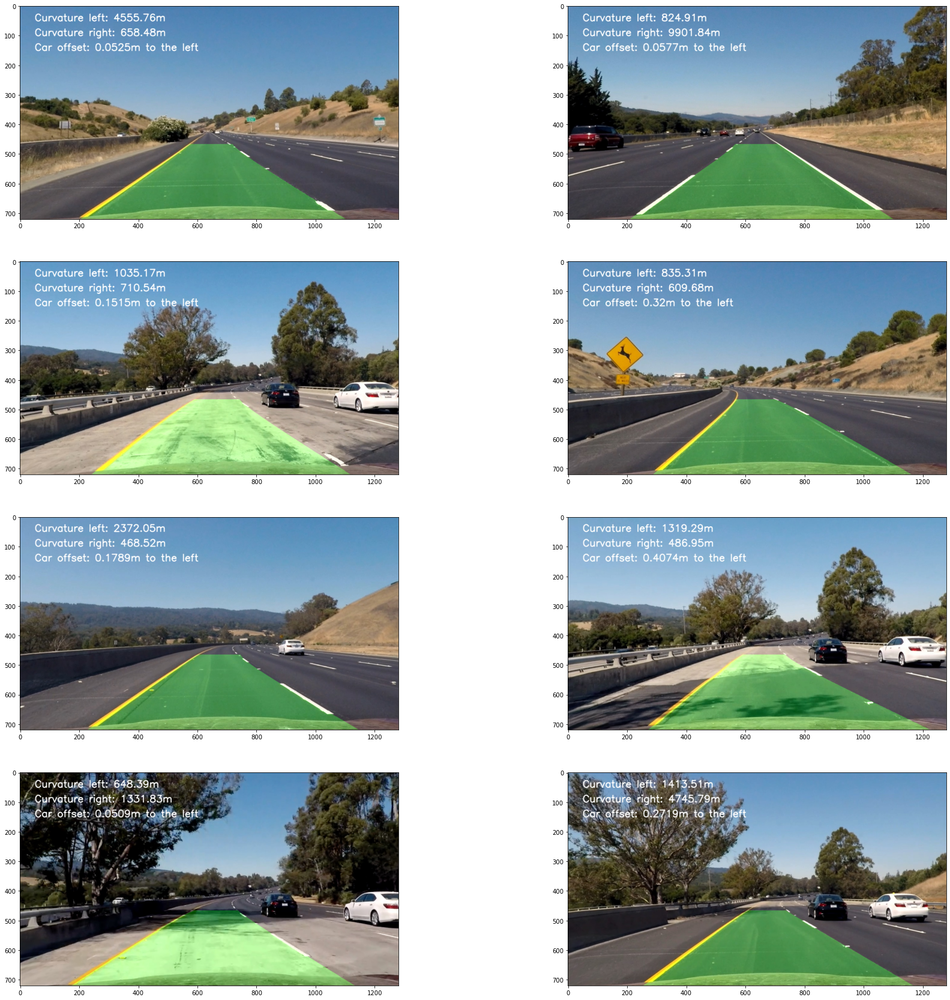

In [35]:
fig, axes = plt.subplots(4, 2, figsize=(30, 30))


for name, ax in zip(rawImages, axes.ravel()):
    left_line = Line()
    right_line = Line()
    
    image = cv2.imread(name)
    img = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
    processed = processing_pipeline(img, left_line, right_line)
    ax.imshow(processed)

# Process video

In [36]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [37]:
def process_image(image):      
    result = processing_pipeline(image, left_line, right_line)
    return result

In [38]:
left_line = Line()
right_line = Line()

output = 'output_images/project_video.mp4'
clip1 = VideoFileClip("project_video.mp4")
p_clip1 = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time p_clip1.write_videofile(output, audio=False)

Moviepy - Building video output_images/project_video.mp4.
Moviepy - Writing video output_images/project_video.mp4



Moviepy - Done !
Moviepy - video ready output_images/project_video.mp4
Wall time: 8min 56s


In [39]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))

# Process video 2 

In [40]:
left_line = Line()
right_line = Line()

output2 = 'output_images/challenge_video.mp4'
##clip2 = VideoFileClip("challenge_video.mp4").subclip(0,5)
clip2 = VideoFileClip("challenge_video.mp4")
p_clip2 = clip2.fl_image(process_image) #NOTE: this function expects color images!!
%time p_clip2.write_videofile(output2, audio=False)

Moviepy - Building video output_images/challenge_video.mp4.
Moviepy - Writing video output_images/challenge_video.mp4



Moviepy - Done !
Moviepy - video ready output_images/challenge_video.mp4
Wall time: 3min 18s


In [41]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output2))

In [42]:
left_line = Line()
right_line = Line()

output3 = 'output_images/harder_challenge_video.mp4'
clip3 = VideoFileClip("harder_challenge_video.mp4")
p_clip3 = clip3.fl_image(process_image) #NOTE: this function expects color images!!
%time p_clip3.write_videofile(output3, audio=False)

Moviepy - Building video output_images/harder_challenge_video.mp4.
Moviepy - Writing video output_images/harder_challenge_video.mp4



Moviepy - Done !
Moviepy - video ready output_images/harder_challenge_video.mp4
Wall time: 9min 29s


In [43]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output3))